## Demo to use AI-driven Cloud Classification Atlas:AICCA 
Author: Takuya Kurihana  
About scientific background, please read our [paper](https://www.mdpi.com/2072-4292/14/22/5690). 

The AI-driven Cloud Classification Atlas delivers the information from multi-spectral satellite imagery from NASA MODIS Aqua and Terra instruments in a compact form (from 800TB to 50GB, excluding metadata), enables data-driven diagnosis of patterns of cloud organization, provides insight into cloud evolution on timescales of hours to decades, and helps democratize climate research by facilitating access to core data.

This notebook gives an example of usage of AICCA dataset following the python functions and visualizations at a high-level.

Example datasets can be downloaded from a Globus endpoint (please download here: Globus endpoint). You need to register Globus, a high-speed data transfer service, to download AICCA dataset. Note that to facilliate the use of AICCA Patch-Level data in Python Pandas framework, we composite all patch labels, four physical variables (cloud optical thickness, cloud top pressure, cloud effective radius, and cloud liquid/ice phase), with latitude and longitude values that are provided by external MOD03/MYD03 products into CSV format.

-------------------------------
### Import libraries

In [5]:
import os
import glob
import time
import datetime
import pandas as pd
import numpy as np

try:
  import netCDF4
except:
  ! pip install netCDF4

In [7]:
# visualizatino libraries below
import matplotlib
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap, LinearSegmentedColormap

try:
    import cartopy
    import cartopy as cart
    import cartopy.crs as ccrs
    import cartopy.feature as cfeature
except:
    ! pip install cartopy
    pass
  
try:
  import plotly.express as px
except:
  ! pip install plotly
  import plotly.express as px
  pass

### Helper functions

In [8]:
def read_csv_per_day(year:int, sday:int, eday:int, basedir:str, usecols=None) -> pd.core.frame.DataFrame:
    """function to read data here for each day
    """
    # read both aqua and terra data
    csvlist = []
    for day in range(sday, eday+1,1):
      csvlist.extend(glob.glob(os.path.join( *[basedir, f"{year}" ,
                                            f"{year}_{str(day).zfill(3)}*.csv"]))
                    )
    if len(csvlist) == 0:
        return pd.DataFrame()
    df = pd.concat([ pd.read_csv(x, usecols=usecols) 
                    for x in csvlist], axis=0).reset_index().drop(labels=['index'], axis=1)
    
    # transform string timestamp to datetime object
    def convert_to_dt(x):
      return datetime.datetime.strptime(str(x)[:19], '%Y-%m-%d %H:%M:%S')
    try:
      df['Timestamp'] = df.Timestamp.apply(lambda x: convert_to_dt(x) )
    except:
      pass
    return df  

In [9]:
def new_grid_estimator_decimal(x, lat_array):
    ex = lat_array[np.argmin(np.abs(lat_array-x))]
    return ex

def new_grid_lon_helper(x, lon_array):
        x = lon_array[np.argmin(np.abs(lon_array-x))]
        if x == -180:
            x = 180
        return x

In [10]:
def calc_local_rfo_label_grid(df_all, nlats=180, nlons=360, south=-89.5, north=89.5, west=-179, east=180, 
                              degree=1, nclusters=42, variables=['Cloud_Fraction']) -> np.ndarray:
    """function to calculate relative frequency of occurrence per N degree x N degree grid cell
    """        
    # assume one lat/lon grid has one assignment
    cluster_array   =  np.zeros((nlats,nlons, nclusters))
    count_array  =  np.zeros((nlats,nlons))
    phys_array      =  np.zeros((nlats,nlons, nclusters, len(variables))).astype(np.float32)    
            
    # subset df per cluster
    lat_array = np.linspace(south, north, nlats)
    lon_array = np.linspace(west , east , nlons)
    
    # round for lat and lon at grid-cell
    df_all['lat'] = df_all['lat'].apply(lambda x: new_grid_estimator_decimal(x, lat_array) if not np.isnan(x) else np.nan)
    df_all['lon'] = df_all['lon'].apply(lambda x: new_grid_lon_helper(x, lon_array) if not np.isnan(x) else np.nan)
    
    # subset
    dfd = df_all.groupby(['lat', 'lon','Label']).size().reset_index(name='counts')  #denomi

    # select specific cluster
    pdf =  df_all.groupby(['lat', 'lon','Label']).mean()
    
    if len(dfd) > 1 and len(pdf) > 1:
      for (_, rS) , ((ilat, ilon, il), pS) in zip(dfd.iterrows(), pdf.iterrows()) : 
        #print(ilat, ilon, int(np.argwhere(lat_array == ilat)), np.argwhere(lon_array == ilon))
        lat_idx = int(np.argwhere(lat_array == ilat))
        lon_idx = int(np.argwhere(lon_array == ilon))
        cluster_array[lat_idx, lon_idx, il-1] = rS.counts # index 0 starts but label starts from 1
        for vdx, variable in enumerate(variables):
            phys_array[lat_idx, lon_idx, il-1, vdx] += pS[variable]
    
      count_array = np.nansum(cluster_array, axis=(-1))
    return cluster_array , phys_array, count_array 

### Download and place sample AICCA dataset

In [17]:
aiccadir='/home/tkuri/clouds/aicca-example/AICCA-csv-public'
# an example notebook place aiccca dataset under a repository ./AICCA-csv-public/2021/*.csv

### Plotting patch-label per day
Please change and specify `basedir` where you placed downloaded sample AICCA dataset.

In [11]:
df = read_csv_per_day(year=2021, sday=1, eday=1, basedir=aiccadir)

In [13]:
df.columns

Index(['Label', 'Timestamp', 'Cloud_Optical_Thickness_mean',
       'Cloud_Optical_Thickness_std', 'Cloud_Phase_Infrared_clear-sky',
       'Cloud_Phase_Infrared_liquid', 'Cloud_Phase_Infrared_ice',
       'Cloud_Phase_Infrared_undef', 'Cloud_Top_Pressure_mean',
       'Cloud_Top_Pressure_std', 'Cloud_Effective_Radius_mean',
       'Cloud_Effective_Radius_std', 'lat', 'lon', 'platform', 'swath'],
      dtype='object')

In [12]:
df

,Label,Timestamp,Cloud_Optical_Thickness_mean,Cloud_Optical_Thickness_std,Cloud_Phase_Infrared_clear-sky,Cloud_Phase_Infrared_liquid,Cloud_Phase_Infrared_ice,Cloud_Phase_Infrared_undef,Cloud_Top_Pressure_mean,Cloud_Top_Pressure_std,Cloud_Effective_Radius_mean,Cloud_Effective_Radius_std,lat,lon,platform,swath
0,29,2021-01-01 00:45:00,5.970236,8.277431,10036,6348,0,0,971.88330,44.941257,21.232635,4.908980,24.750641,-165.212952,AQUA,45
1,38,2021-01-01 00:45:00,10.538337,9.209682,9785,6595,4,0,935.20306,57.157010,19.885970,3.827088,23.986673,-171.365753,AQUA,45
2,38,2021-01-01 00:45:00,9.017957,7.471433,9425,6950,9,0,942.85890,48.381252,16.349905,4.451598,23.796793,-172.634094,AQUA,45
3,26,2021-01-01 00:45:00,12.555588,10.668962,568,15192,370,254,882.07166,118.820030,17.113518,6.833513,26.159325,-162.341675,AQUA,45
4,33,2021-01-01 00:45:00,10.218677,8.384299,281,16103,0,0,901.36560,40.659824,15.468930,3.718772,25.884571,-165.434036,AQUA,45
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19422,13,2021-01-01 22:40:00,23.842093,13.963388,137,14032,1364,851,662.51404,69.873640,8.444285,1.975257,-69.076866,173.788773,TERRA,2240
19423,13,2021-01-01 22:40:00,23.844763,14.205302,0,16149,51,184,692.39530,77.484985,12.715726,6.023881,-64.111183,136.855545,TERRA,2240
19424,16,2021-01-01 22:40:00,13.369909,8.898944,200,13523,2034,627,849.70060,83.578320,12.577571,7.279711,-65.854858,142.344406,TERRA,2240
19425,14,2021-01-01 22:40:00,8.054954,4.557443,3310,6031,6383,660,855.02680,110.584150,11.143586,5.933965,-69.894341,166.946014,TERRA,2240


/home/tkuri/anaconda3/envs/binder/lib/python3.8/site-packages/cartopy/crs.py:245: ShapelyDeprecationWarning: __len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check the length of the `geoms` property instead to get the  number of parts of a multi-part geometry.
  if len(multi_line_string) > 1:
/home/tkuri/anaconda3/envs/binder/lib/python3.8/site-packages/cartopy/crs.py:297: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  for line in multi_line_string:
/home/tkuri/anaconda3/envs/binder/lib/python3.8/site-packages/cartopy/crs.py:364: ShapelyDeprecationWarning: __len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check the length of the `geoms` property instead to get the  number of parts of a multi-part geometry.
  if len(p_mline) > 0:
/home/tkuri/anaconda3/envs/binder/lib/py

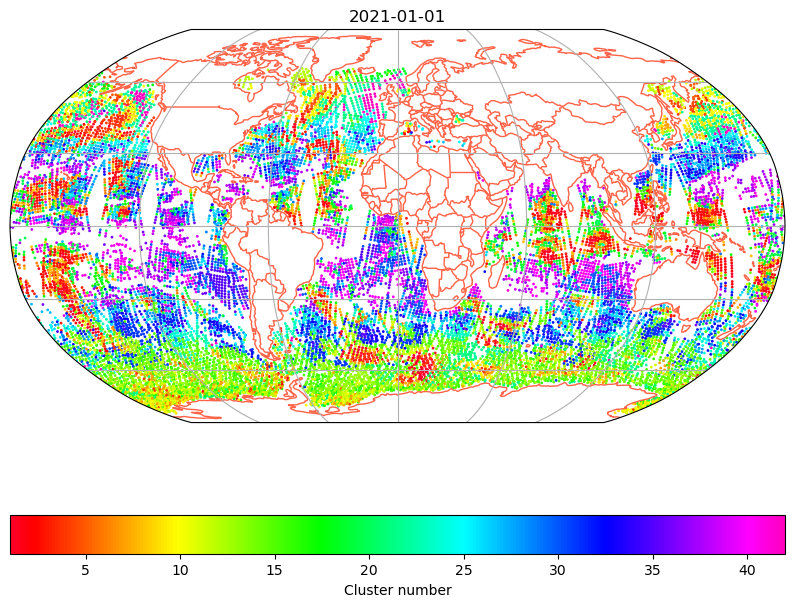

In [14]:
fig = plt.figure(figsize=(10,8))

ax = fig.add_subplot(1,1,1, projection=ccrs.Robinson())

ax.set_global()

ax.add_feature(cfeature.COASTLINE, edgecolor="tomato")
ax.add_feature(cfeature.BORDERS, edgecolor="tomato")
ax.gridlines()

sc = plt.scatter(x=df.lon, y=df.lat,
            c=df.Label,
            cmap='gist_rainbow',
            s=1,
            transform=ccrs.PlateCarree()) ## Important
cbar = plt.colorbar(sc, orientation='horizontal')
cbar.ax.set_xlabel('Cluster number')
plt.title('2021-01-01')
plt.show()

### Calculate and Plot Relative Frequency of Occurence (RFO) per week

In [15]:
def main(year, sday, eday, aiccadir, usecols=None, nlats=180, nlons=360, variables=[]):
  """caluclate RFO from sday to eday. 
      Input
        aiccadir (str) : directory name where you downloaded our example aicca dataset

      Output
        rfo_array (np.nd.array) : array of rfo values ranging in [0,1]. you may want to multiply x 100 when plotting
        mphys_array (np.nd.array) : mean physical parameter values per grid per cluster

  """
  rfo_array = None
  mphys_array = None
  
  t1 = time.time()
  for day in range(sday, eday+1, 1):
    df = read_csv_per_day(year=year, sday=sday, eday=eday, 
                          basedir=aiccadir, usecols=usecols)
    
  # calculate rfo and mean physics values per grid
  _cluster_array , _phys_array, count_array = calc_local_rfo_label_grid(df, nlats, nlons, variables=variables) 

  # switch axis for computation
  _cluster_array = np.moveaxis(_cluster_array, -1, 0)
  _phys_array = np.moveaxis(_phys_array, -1, 0)
  if rfo_array is None  and mphys_array is None:
        rfo_array   =  np.expand_dims(
                      np.divide(_cluster_array, count_array, out=np.zeros_like(_cluster_array), where=count_array!=0), axis=-1)
        mphys_array =  np.expand_dims(_phys_array,axis=-1)

  t2 = time.time() - t1
  print(f"Processing time == {t2/60.00} min", flush=True)
  # axis roll
  rfo_array = np.moveaxis(rfo_array, 0, -2) # (nlats, nlons, nlabels, ntimes)
  mphys_array = np.moveaxis(mphys_array, 0, -2)
  return rfo_array, mphys_array

In [16]:
# variables: col name of dataframe to get mean per grid values
variables =  [
    'Cloud_Optical_Thickness_mean',
    'Cloud_Top_Pressure_mean',
]

In [18]:
rfo_array, mphys_array = main(2021, 1, 7,
                              aiccadir=aiccadir, 
                              nlats=180, nlons=360, variables=variables)

/tmp/ipykernel_9020/2779744497.py:22: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  pdf =  df_all.groupby(['lat', 'lon','Label']).mean()


Processing time == 0.3867577115694682 min


In [19]:
rfo_array.shape, mphys_array.shape

((180, 360, 42, 1), (180, 360, 42, 2, 1))

#### Make a custom cmap
A custom colormap color used at Figure.9 in our [paper](https://www.mdpi.com/2072-4292/14/22/5690)

In [20]:
def get_cmap(cmapname, nlevels):
    cmap = matplotlib.cm.get_cmap(cmapname, nlevels)    # PiYG

    colors = []
    for i in range(cmap.N):
        rgba = cmap(i)
        # rgb2hex accepts rgb or rgba
        colors.append(matplotlib.colors.rgb2hex(rgba))
    return colors

In [21]:
# we used three default cmap in matplotlib
bupu = get_cmap('BuPu', nlevels=11)
ocean_r = get_cmap('ocean_r', nlevels=11)
cool = get_cmap('cool', nlevels=11)

In [22]:
mycolor_list = ocean_r[:1]+ocean_r[3:4]+ocean_r[6:7]+[bupu[-2]]+cool[-2:-1]

In [23]:
mycmap = LinearSegmentedColormap.from_list("mycmap",mycolor_list )

#### Plotting RFOs for individual cluster

In [24]:
lats = np.linspace(-89.5, 89.5, 180)
lons = np.linspace(-179, 180 , 360)
LONS, LATS = np.meshgrid(lons, lats)

In [25]:
cluster_number = 35

/home/tkuri/anaconda3/envs/binder/lib/python3.8/site-packages/cartopy/crs.py:245: ShapelyDeprecationWarning: __len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check the length of the `geoms` property instead to get the  number of parts of a multi-part geometry.
  if len(multi_line_string) > 1:
/home/tkuri/anaconda3/envs/binder/lib/python3.8/site-packages/cartopy/crs.py:256: ShapelyDeprecationWarning: __len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check the length of the `geoms` property instead to get the  number of parts of a multi-part geometry.
  line_strings = list(multi_line_string)
/home/tkuri/anaconda3/envs/binder/lib/python3.8/site-packages/cartopy/crs.py:256: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  line_strings = list(multi_line_string)
/home/tkuri/an

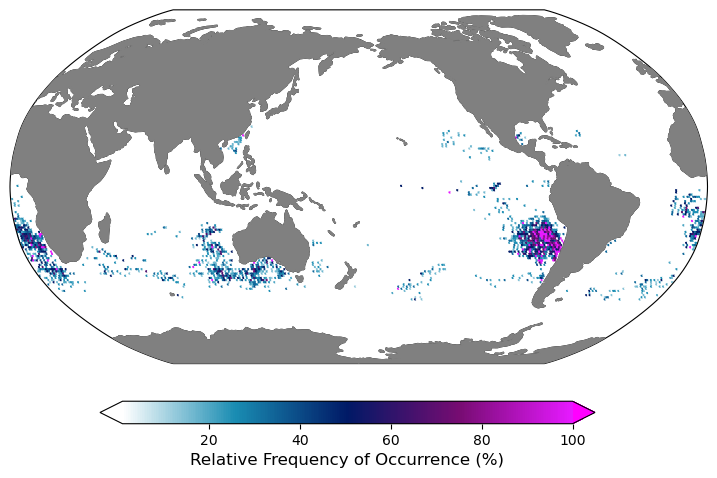

In [26]:
cbar_axes=[0.225, 0.1, 0.55, 0.0375]


fig = plt.figure(figsize=(9,6))
ax = fig.add_subplot(1,1, 1, projection=ccrs.Robinson(central_longitude=180.0))
  
mycmap.set_under(color='white')
mycmap.set_over(color='#ff00ff')

LONS, LATS = np.meshgrid(lons, lats)
CS = ax.scatter(LONS, LATS,c=rfo_array[:,:,cluster_number-1,0]*100,
            transform=ccrs.PlateCarree(),
            cmap=mycmap,
            s=1,
            vmin=1,vmax=100, rasterized=True)
ax.coastlines()
ax.add_feature(cart.feature.LAND, color='gray',zorder=100, edgecolor='k')
ax.set_global()
cax = plt.axes(cbar_axes)
cbar = fig.colorbar(CS,cax=cax,orientation = 'horizontal', extend='both') # linewidths; default = 1.5
cbar.ax.set_xlabel('Relative Frequency of Occurrence (%)', fontsize=12)
plt.show()

### Scroll different cluster patterns from class 1 to 42

In [27]:
lats = np.linspace(-89.5, 89.5, 180)
lons = np.linspace(-179, 180 , 360)
LONS, LATS = np.meshgrid(lons, lats)

In [28]:
# from numpy to dataframe
ny, nx, nc, _ = rfo_array.shape
lats_list = []
lons_list = []
rfos_list = []
labels_list = []
cots_list = []
ctps_list = []
for iy in range(ny):
  for ix in range(nx):
    for ic in range(42):
      r = float(rfo_array[iy, ix, ic])
      if r > 0:
        lats_list.append(lats[iy])
        lons_list.append(lons[ix])
        rfos_list.append(r*100.0) # [0,1] --> [0,100]
        labels_list.append(ic+1)
        cots_list.append(float(mphys_array[iy, ix, ic, 0]))
        ctps_list.append(float(mphys_array[iy, ix, ic, 1]))


sample_df = pd.DataFrame( np.concatenate(
    [ np.array(lats_list).reshape(-1,1), np.array(lons_list).reshape(-1,1), 
     np.array(labels_list).reshape(-1,1), np.array(rfos_list).reshape(-1,1),
     np.array(cots_list).reshape(-1,1), np.array(ctps_list).reshape(-1,1),
     ],axis=1
), columns=['Latitude', 'Longitude', 'Label', 'RFO']+variables )
sample_df['Label'] = sample_df['Label'].astype('int64', copy=False)

In [34]:
sample_df

,Latitude,Longitude,Label,RFO,Cloud_Optical_Thickness_mean,Cloud_Top_Pressure_mean
0,-83.5,-179.0,9,50.0,11.541706,844.027954
1,-83.5,-179.0,10,50.0,13.581081,618.830261
2,-82.5,-179.0,9,50.0,14.091793,813.256714
3,-82.5,-179.0,10,50.0,14.660854,830.404114
4,-82.5,-178.0,9,50.0,10.271400,755.200867
...,...,...,...,...,...,...
106586,67.5,-5.0,18,100.0,NaN,834.554993
106587,67.5,-2.0,18,100.0,NaN,918.714050
106588,67.5,2.0,5,100.0,NaN,424.015198
106589,67.5,7.0,12,100.0,NaN,655.737000


In [37]:
fig = px.scatter_mapbox(sample_df,
              lat="Latitude" ,
              lon="Longitude",
              hover_name="RFO",
              hover_data=variables,
              color="RFO",
              animation_frame='Label',
              mapbox_style='carto-positron',  
              category_orders={
                'Label':list(np.sort(sample_df['Label'].unique()))
              },                
              zoom=3)
fig.show()